# Машинное обучение, ВМК МГУ

# Практическое задание 3. Обучение без учителя.

## Общая информация
Дата выдачи: 31.03.2025

Мягкий дедлайн: 15.04.2025 05:00 MSK

Жёсткий дедлайн: 22.04.2025 05:00 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-1-Username.ipynb

Username — ваша фамилия на латинице

## О задании



В этом задании вам предлагается поработать с различными методами кластеризации и посмотреть их работу на различных данных

In [ ]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

## Часть 1. Тематическое моделирование текстов.

В этом задании мы сравним разные алгоритмы кластеризации для задачи тематического моделирования.

**Задание 1.1 (1 балл).** Для начала реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Здесь необходимо использовать вариацию с ненормированным лапласианом.

In [ ]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans
import scipy

class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''

        laplacian = scipy.sparse.csgraph.laplacian(X, normed=False)

        _, eigenvectors = scipy.linalg.eigh(laplacian)
        return eigenvectors[:, :self.n_components]

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [ ]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

**Задание 1.2 (0.5 балла)** Теперь приступим к применению разных алгоритмов кластеризации для одной из самых популярных задач обучения без учителя: задачи тематического моделирования текстов.

Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. То есть, фактически, перед вами стоит задача кластеризации текстов с тем лишь дополнением что требется не только разбить тексты на группы, но и выделить ключевые слова, определяющие каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [ ]:
import os
import shutil
os.makedirs('/root/.kaggle', exist_ok=True)
kaggle_json = '{"username":"roman1532","key":"2bb993426dc946baab085bf16a0e54c4"}'
with open('/root/.kaggle/kaggle.json', 'w') as f:
    f.write(kaggle_json)
os.chmod('/root/.kaggle/kaggle.json', 0o600)
!kaggle datasets download -d hgultekin/bbcnewsarchive
!unzip bbcnewsarchive.zip

Dataset URL: https://www.kaggle.com/datasets/hgultekin/bbcnewsarchive
License(s): copyright-authors
Archive:  bbcnewsarchive.zip
  inflating: bbc-news-data.csv       


In [ ]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1120,politics,225.txt,Blair to face MPs amid feud talk,Tony Blair faces his first prime minister's q...
1659,sport,347.txt,Moore questions captaincy,Brian Moore believes the England captain shou...
950,politics,055.txt,Kelly trails new discipline power,Teachers could get more powers to remove unru...
18,business,019.txt,India widens access to telecoms,India has raised the limit for foreign direct...
214,business,215.txt,SEC to rethink post-Enron rules,The US stock market watchdog's chairman has s...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [ ]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
nltk.download('punkt_tab')
nltk.download('wordnet')
STOPWORDS = nltk.corpus.stopwords.words('english')
data['text'] = data['title'] + data['content']
data['text'] = data['text'].str.lower()
lemmatizer = WordNetLemmatizer()
def preprocess_text(text):
    tokens = word_tokenize(text)
    tokens = [word for word in tokens if word.isalpha()]
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in STOPWORDS]
    return " ".join(tokens)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [ ]:
data['text'] = data['text'].apply(preprocess_text)
data = data.drop(columns=['title', 'content'])

In [ ]:
data

,category,filename,text
0,business,001.txt,ad sale boost time warner profit quarterly pro...
1,business,002.txt,dollar gain greenspan speech dollar hit highes...
2,business,003.txt,yukos unit buyer face loan claim owner embattl...
3,business,004.txt,high fuel price hit ba profit british airway b...
4,business,005.txt,pernod takeover talk lift domecq share uk drin...
...,...,...,...
2220,tech,397.txt,bt program beat dialler scam bt introducing tw...
2221,tech,398.txt,spam tempt net shopper computer user across wo...
2222,tech,399.txt,careful code new european directive could put ...
2223,tech,400.txt,u cyber security chief resigns man making sure...


Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [ ]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

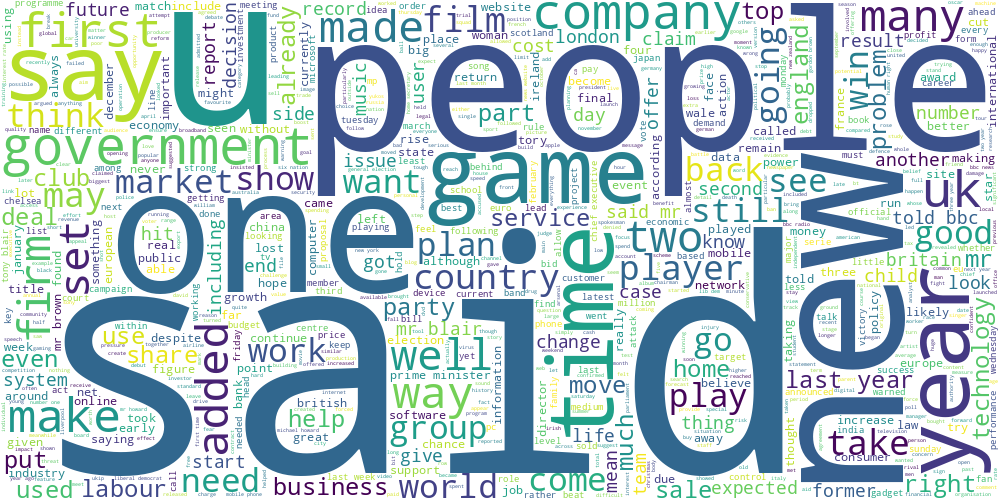

In [12]:
draw_wordcloud(data.text)

**Задание 1.3 (1 балл).** Начнем с простого: обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. (?) Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:**

In [10]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
texts = [tokens for tokens in data['text']]
vectorizer = TfidfVectorizer(max_df=0.85, min_df=5, stop_words='english')
X = vectorizer.fit_transform(data['text'])
n_clusters = 8
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X)

KMeans(random_state=42)

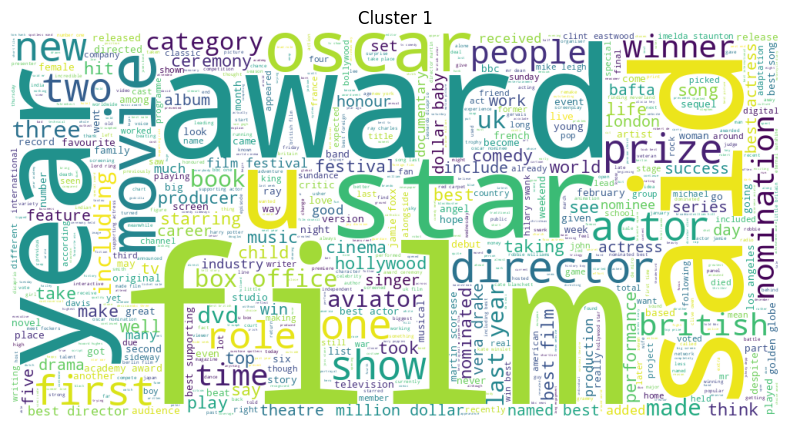

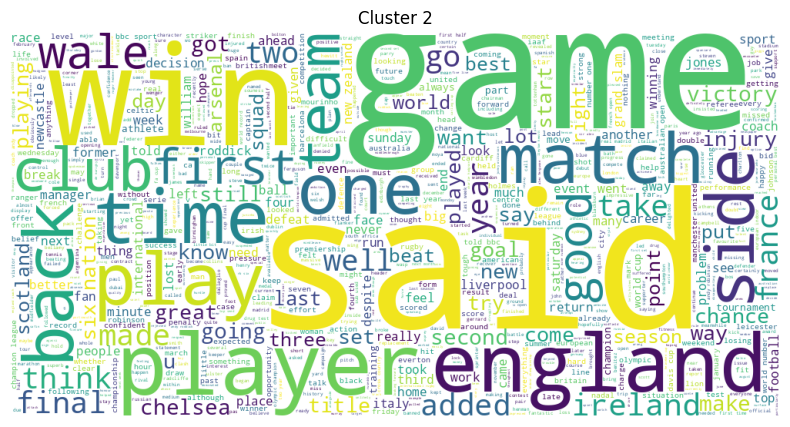

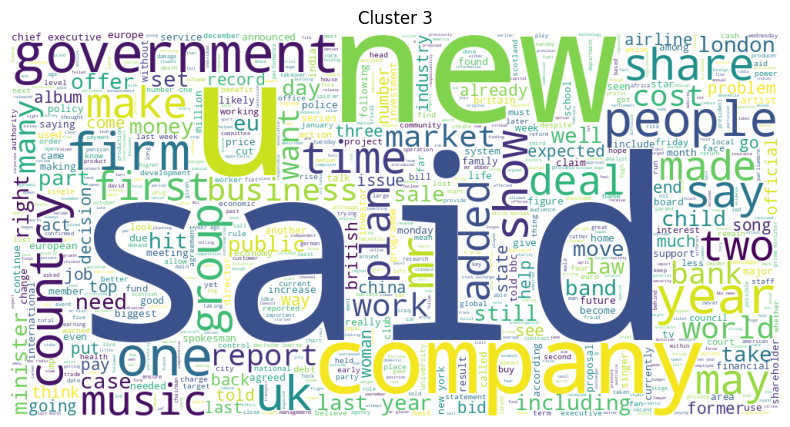

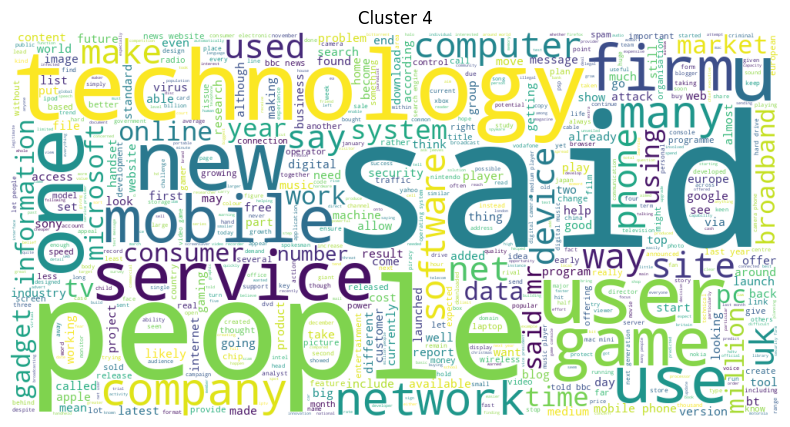

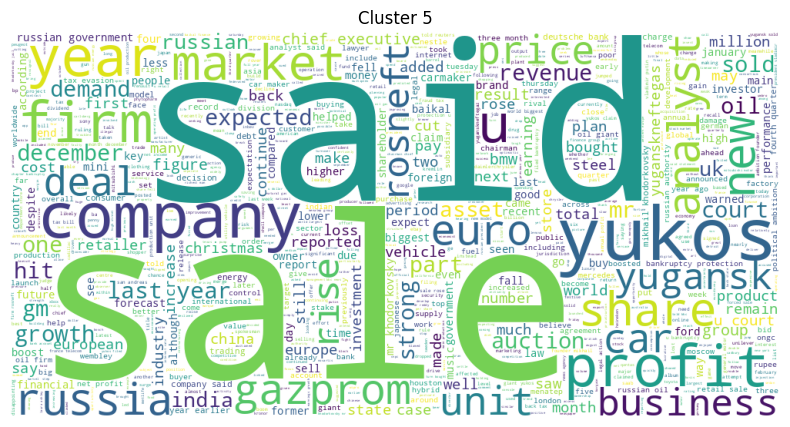

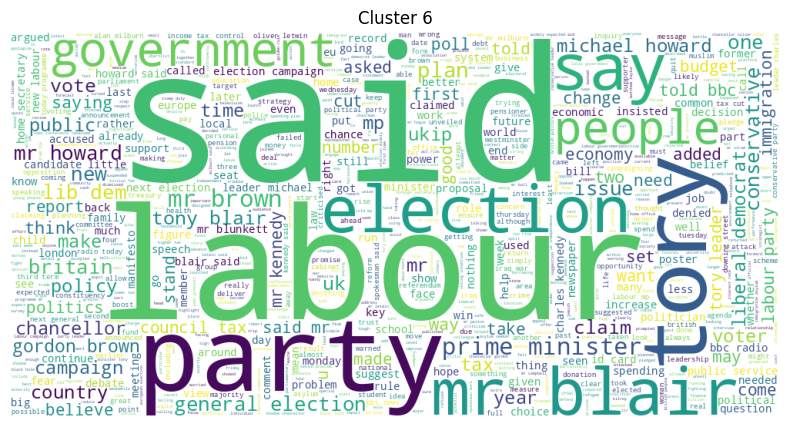

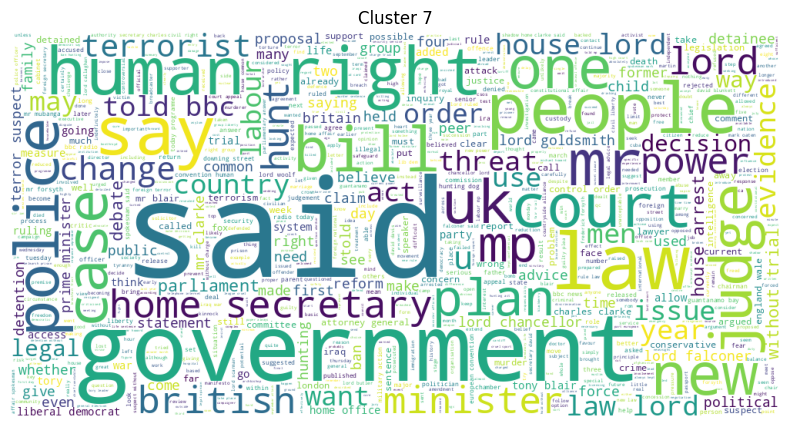

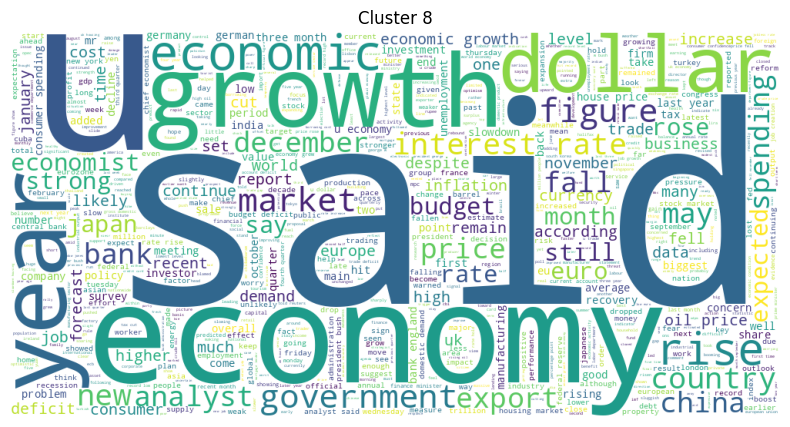

In [11]:
labels = kmeans.labels_
for cluster_id in range(n_clusters):
    cluster_indices = np.where(labels == cluster_id)[0]
    cluster_texts = [texts[i] for i in cluster_indices]
    img = draw_wordcloud(cluster_texts)

    plt.figure(figsize=(10, 5))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'Cluster {cluster_id+1}')
    plt.show()

Кластер 1 - кино,
Кластер 2 - игры,
Кластер 3 - политика,
Кластер 4 - информационные технологии,
Кластер 5 - Российские нефтедобывающие компании,
Кластер 6 - политика Британии,
Кластер 7 - судебные разбирательства в Британии,
Кластер 8 - экономика.

**Задание 1.4 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на несколько слов с наибольшими числовыми значениями. (?) Соответствуют ли полученные слова облакам тегов из прошлого задания?

**Ответ:** Соответствует, проглядываются те же темы

In [13]:
centroids = kmeans.cluster_centers_
feature_names = np.array(vectorizer.get_feature_names_out())
top_n = 10
for i in range(n_clusters):
    print(f"Cluster {i+1}:")
    top_indices = centroids[i].argsort()[-top_n:][::-1]
    top_words = feature_names[top_indices]
    print("Top words:", ", ".join(top_words))
    print("-" * 40)


Cluster 1:
Top words: film, award, best, oscar, actor, star, festival, director, actress, nomination
----------------------------------------
Cluster 2:
Top words: game, england, player, win, said, match, cup, champion, team, club
----------------------------------------
Cluster 3:
Top words: said, mr, company, year, government, firm, new, bank, music, share
----------------------------------------
Cluster 4:
Top words: mobile, phone, people, technology, said, user, service, computer, game, digital
----------------------------------------
Cluster 5:
Top words: sale, yukos, profit, company, firm, said, oil, russian, year, share
----------------------------------------
Cluster 6:
Top words: mr, labour, election, party, blair, tory, brown, said, tax, howard
----------------------------------------
Cluster 7:
Top words: lord, said, law, government, police, house, court, right, human, mr
----------------------------------------
Cluster 8:
Top words: economy, growth, rate, economic, price, d

**Задание 1.5 (можно получить 1.5, 1 или 2.5 баллов)** Попробуем усовершенствовать метод. Реализуйте в приведенном ниже шаблоне ядерный K-means(1.5 баллов) или эллипсоидный метод(1 балл) (можно оба сразу, тогда баллы сложатся). И попробуйте применить его для решаемой задачи. (?)Насколько существенно отличаются  центры кластеров и облака тегов от таковых для предыдущих методов?

In [15]:
from sklearn.metrics.pairwise import pairwise_kernels #импортируем применение ядра, чтобы можно было использовать разные ядра
class KernelKMeans:
    def __init__(self, n_clusters, iters, kernel, gamma):
        """
        KMeans Class constructor.

        Args:
        n_clusters (int) : Number of clusters used for partitioning.
        iters (int) : Number of iterations until the algorithm stops.

        """
        self.n_clusters = n_clusters
        self.iters = iters
        self.kernel = kernel
        self.gamma = gamma

    def initialize_clusters(self, X):
        """
        Initialize centroids.

        Args:
        X (ndarray): Dataset samples
        n_clusters (int): Number of clusters

        Returns:
        centroids (ndarray): Initial position of centroids
        """
        n_samples = X.shape[0]
        return np.random.randint(0, self.n_clusters, n_samples)


    def fit_predict(self, X):
        """
        Implementation of the kernel KMeans algorithm.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Computed centroids
        labels (ndarray): Predicts for each sample in the dataset.
        """
        n_samples = X.shape[0]
        self.labels_ = self.initialize_clusters(X)
        K = pairwise_kernels(X, metric=self.kernel, gamma=self.gamma)
        for i in range(self.iters):
            dist = np.zeros((n_samples, self.n_clusters))
            for j in range(self.n_clusters):
                mask = self.labels_ == j
                cluster_size = np.sum(mask)
                if cluster_size == 0:
                    continue
                K_ij = K[mask][:, mask]
                K_ix = K[:, mask]
                dist[:, j] = np.diag(K) \
                            - (2 / cluster_size) * np.sum(K_ix, axis=1) \
                            + (1 / cluster_size ** 2) * np.sum(K_ij)

            self.labels_ = np.argmin(dist, axis=1)
        self.clusters_ = [np.where(self.labels_ == i)[0] for i in range(self.n_clusters)]
        return self.labels_

    def get_centroids(self):
        """
        Return the computed centroids
        """
        return self.clusters_

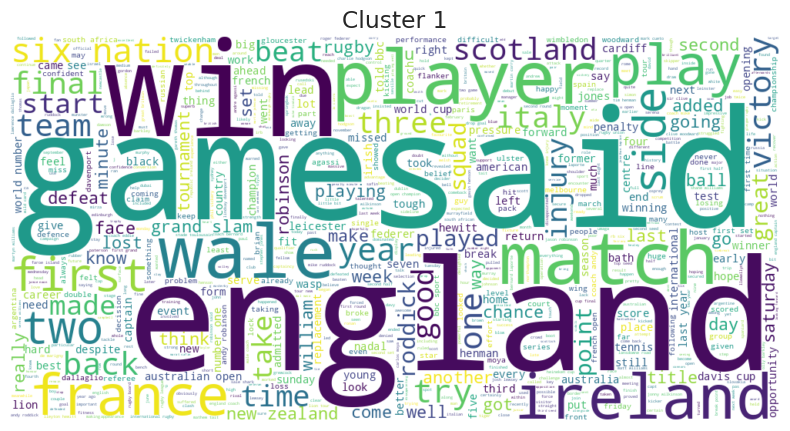

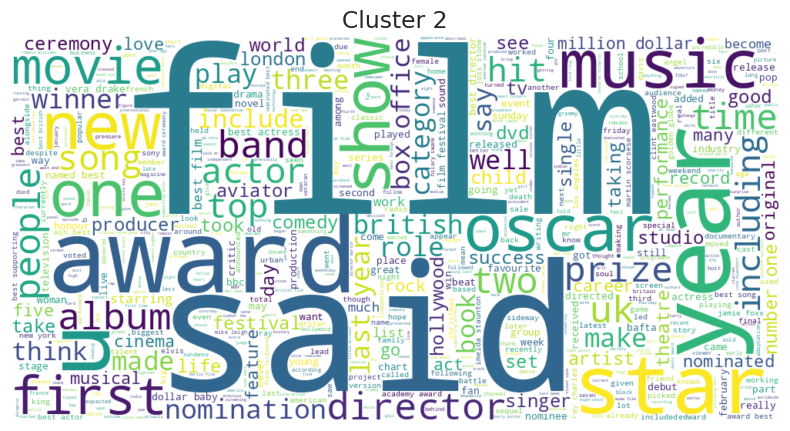

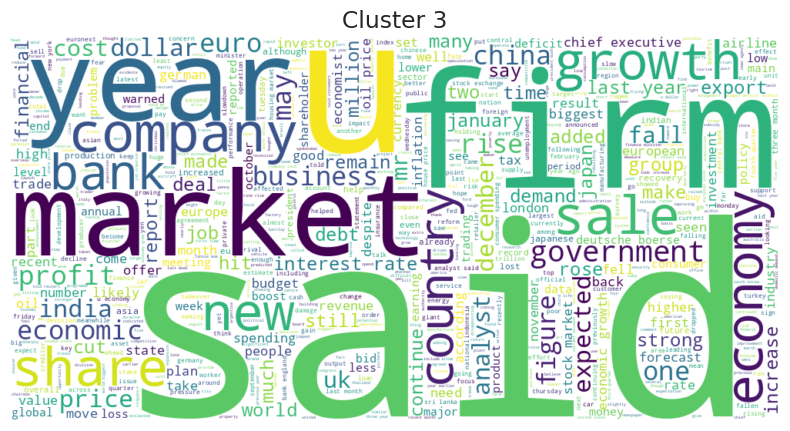

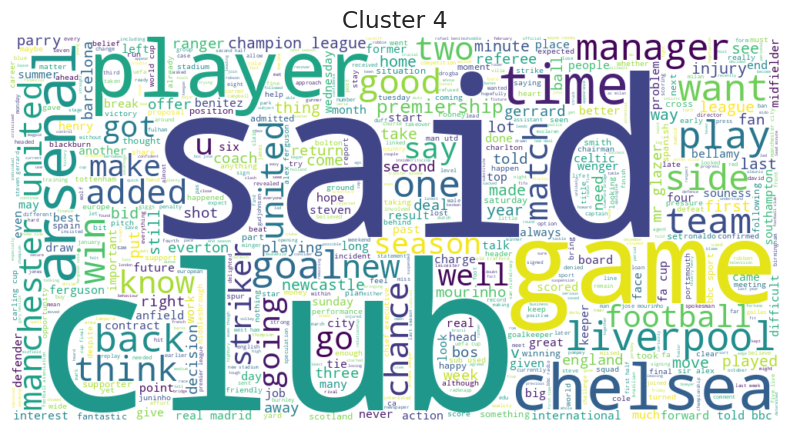

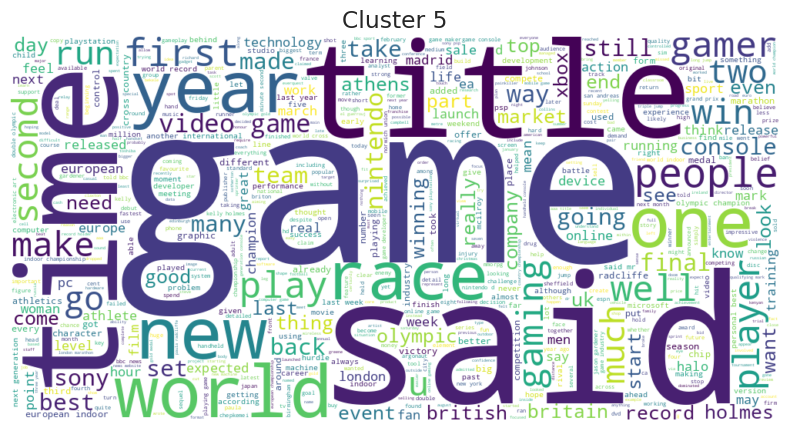

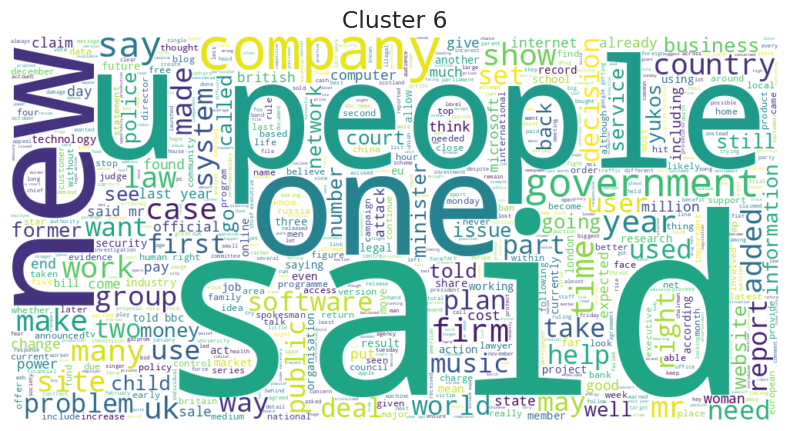

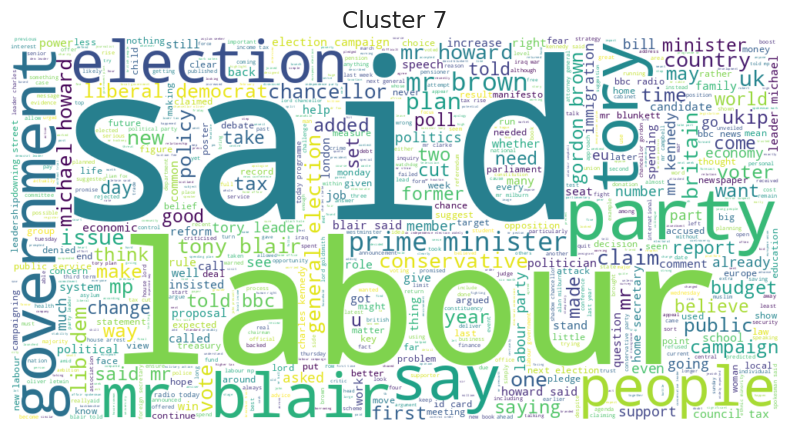

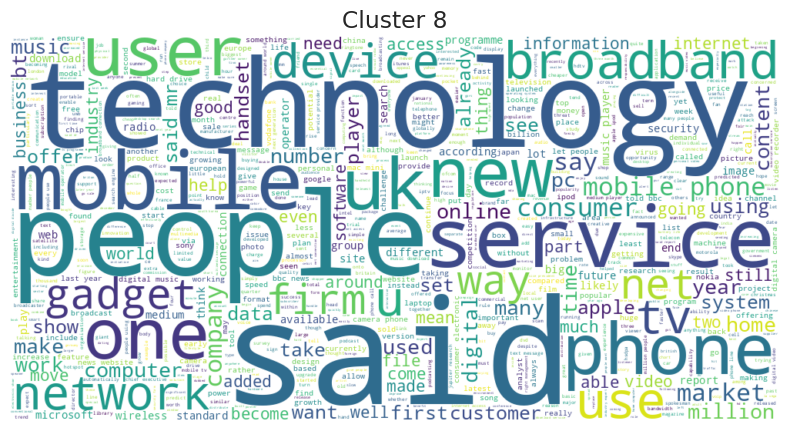

In [55]:
X = vectorizer.fit_transform(data['text'])
kernel_kmeans = KernelKMeans(n_clusters=8, iters=100, kernel='rbf', gamma=0.1)
labels_kernel = kernel_kmeans.fit_predict(X.toarray())
for cluster_id in range(8):
    cluster_indices = np.where(labels_kernel == cluster_id)[0]
    cluster_texts = [texts[i] for i in cluster_indices]

    wordcloud = draw_wordcloud(cluster_texts)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Cluster {cluster_id + 1}')
    plt.show()

Темы
1. Игры и страны, видимо, спорт
2. Кино
3. Экономика, бизнес
4. Футбол
5. Видеоигры
6. Неинтерпретируемая, всё намешано
7. Политика Британии
8. Информационные технологии

In [57]:
n_clusters = 8
top_n = 10
feature_names = np.array(vectorizer.get_feature_names_out())
for i in range(n_clusters):
    print(f"Cluster {i+1}:")
    cluster_indices = kernel_kmeans.get_centroids()[i]
    cluster_texts = [texts[j] for j in cluster_indices]
    cluster_vector = vectorizer.transform(cluster_texts)
    word_freq = np.asarray(cluster_vector.sum(axis=0)).flatten()
    top_indices = word_freq.argsort()[-top_n:][::-1]
    top_words = feature_names[top_indices]
    print("Top words:", ", ".join(top_words))
    print("-" * 40)

Cluster 1:
Top words: england, game, match, ireland, wale, win, rugby, player, france, injury
----------------------------------------
Cluster 2:
Top words: film, award, best, actor, oscar, star, festival, band, album, year
----------------------------------------
Cluster 3:
Top words: growth, said, economy, market, bank, year, price, rate, sale, share
----------------------------------------
Cluster 4:
Top words: club, chelsea, game, arsenal, united, league, player, liverpool, goal, manager
----------------------------------------
Cluster 5:
Top words: game, race, title, world, olympic, indoor, console, holmes, nintendo, gaming
----------------------------------------
Cluster 6:
Top words: said, mr, government, people, company, firm, new, year, law, court
----------------------------------------
Cluster 7:
Top words: mr, labour, election, party, blair, tory, brown, said, tax, howard
----------------------------------------
Cluster 8:
Top words: mobile, phone, technology, digital, peop

Большинство тем совпадают, но некоторые новые всё же появились, например, футбол

**Задание 1.6 (0.5 балла).** Теперь попробуем сравнить три разных алгоритма кластеризации. Получите три разбиения на кластеры с помощью алгоритмов K-Means(любого понравившегося), DBSCAN(можно взять готовый из sklearn) и спектральной кластеризации, реализованной вами выше. Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

In [58]:
from sklearn.metrics.pairwise import rbf_kernel
from sklearn.cluster import DBSCAN
from collections import Counter
from sklearn.metrics.pairwise import cosine_similarity
texts = [tokens for tokens in data['text']]
vectorizer = TfidfVectorizer(max_df=0.85, min_df=5, stop_words='english')
X = vectorizer.fit_transform(texts)
X_dense = X.toarray()
kernel_kmeans = KernelKMeans(n_clusters=8, iters=100, kernel='rbf', gamma=0.1)
labels_kernel = kernel_kmeans.fit_predict(X_dense)

affinity_matrix = rbf_kernel(X_dense, gamma=0.01)
spectral = GraphClustering(n_clusters=8)
labels_spectral = spectral.fit_predict(affinity_matrix)
dbscan = DBSCAN(eps=0.75, min_samples=5, metric='cosine')
labels_dbscan = dbscan.fit_predict(X_dense)


n_dbscan_clusters = len(set(labels_dbscan)) - (1 if -1 in labels_dbscan else 0)
print("Kernel KMeans:", len(np.unique(labels_kernel)))
print("Spectral Clustering:", len(np.unique(labels_spectral)))
print("DBSCAN:", n_dbscan_clusters)

Kernel KMeans: 8
Spectral Clustering: 8
DBSCAN: 12


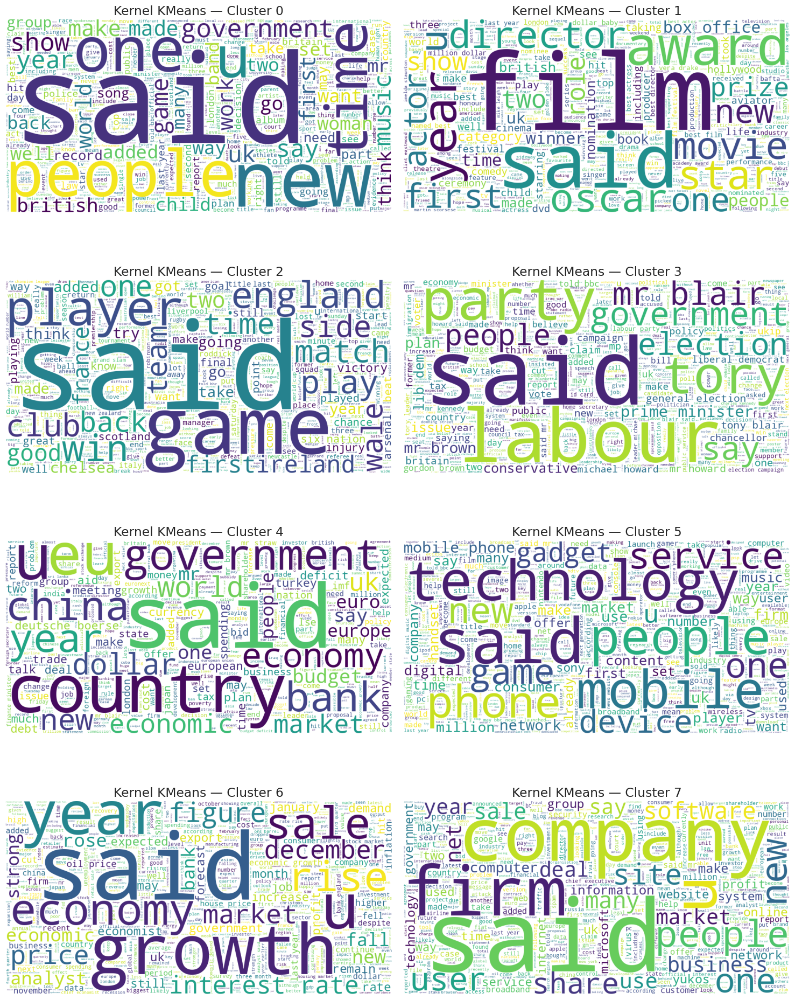

In [59]:
from collections import defaultdict
def plot_all_wordclouds(labels, method_name, texts):
    clusters = defaultdict(list)

    for i, label in enumerate(labels):
        if label == -1:
            continue
        clusters[label].append(texts[i])
    n_clusters = len(clusters)
    n_cols = 2
    n_rows = (n_clusters + 1) // n_cols
    plt.figure(figsize=(15, n_rows * 5))
    for idx, (cluster_id, cluster_texts) in enumerate(sorted(clusters.items())):
        plt.subplot(n_rows, n_cols, idx + 1)
        img = draw_wordcloud(cluster_texts)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f'{method_name} — Cluster {cluster_id}')
    plt.tight_layout()
    plt.show()
plot_all_wordclouds(labels_kernel, "Kernel KMeans", texts)

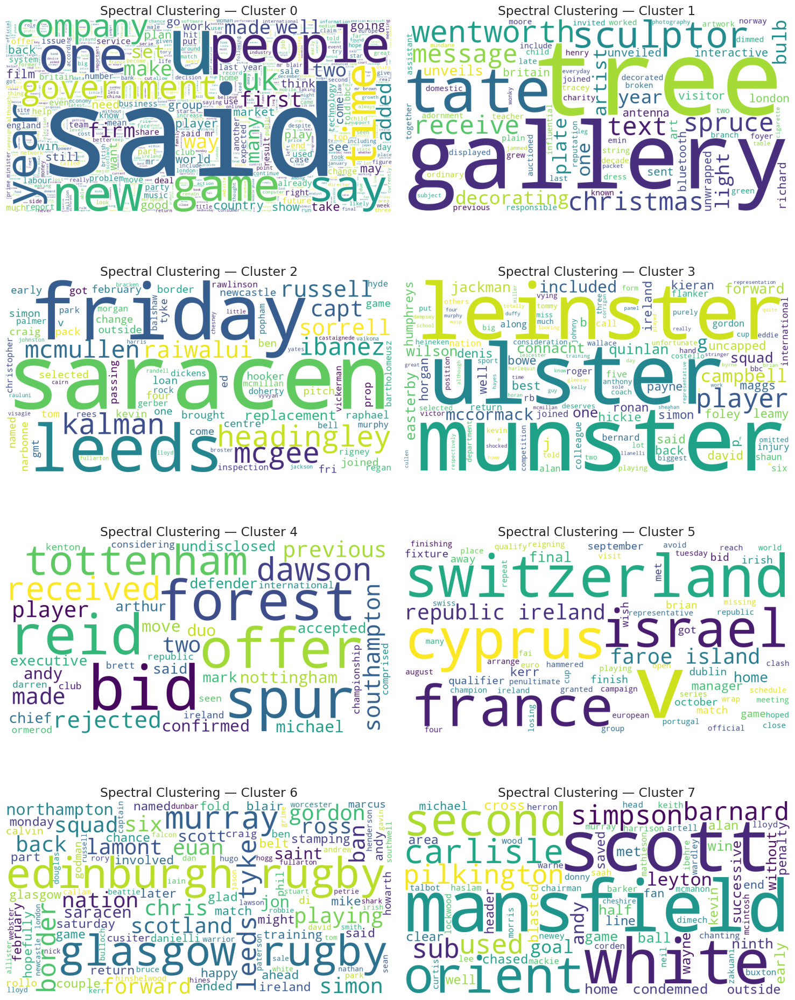

In [60]:
plot_all_wordclouds(labels_spectral, "Spectral Clustering", texts)

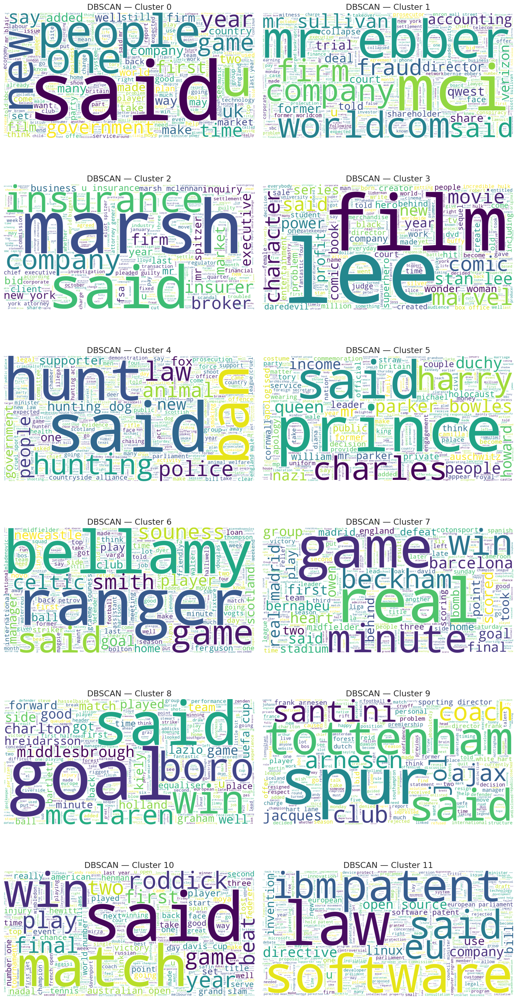

In [61]:
plot_all_wordclouds(labels_dbscan, "DBSCAN", texts)

У ядрового KMeans получились темы, похожие на те, что выделил безядерный KMeans:
1. Неинтерпретируемая
2. Фильмы
3. Игры
4. Выборы Британии
5. Экономика и политика
6. Информационные технологии и гаджеты
7. Экономика
8. Бизнес

Спектральная кластеризация сломалась: одна тема охватывает почти весь словарь, тогда как другие охватывают всего несколько новостей

Темы DBScan:
1. Неинтерпретируемая
2. Бизнес
3. Бизнес
4. Кино
5. Законы об охоте и браконьерстве
6. Королевская семья Британии
7. Спорт
8. Футбол, реал мадрид
9. Футбол
10. Ещё один футбол)
11. Спорт
12. Информационные технологии, патенты

Несколько тем DBScan продублировались, одна неинтерпретируемая, но в целом, темы хорошие. Если поиграться с эпсилоном, уверен, можно получить более симпатичный результат. Но получается, что если у тем разные плотности, то проблему дублирующихся или мусорных тем будет сложно избежать в таком методе

(?) Теперь постройте облака слов и снова проинтерпретируйте темы.

**Задание 1.6 (1 балл).** Также, для анализа качества кластеризации иногда бывает полезно "посмотреть" на кластеры. Обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

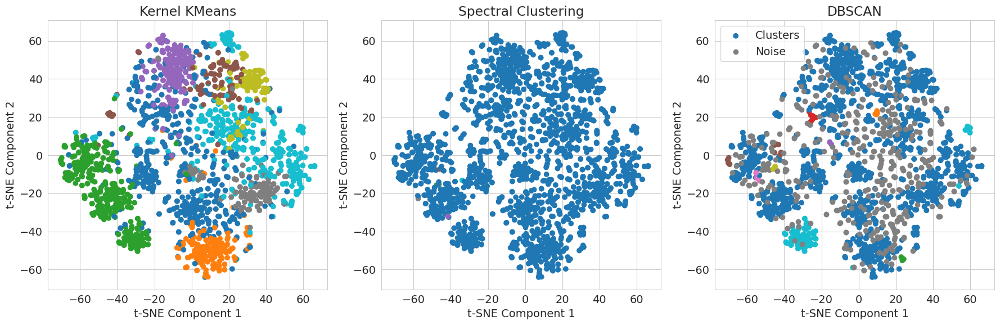

In [62]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams.update({'font.size': 14})
sns.set_style('whitegrid')
def plot_tsne_with_clusters(X, labels_kernel, labels_spectral, labels_dbscan):
    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X.toarray())
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Kernel KMeans
    axes[0].scatter(X_tsne[:, 0], X_tsne[:, 1], c=labels_kernel, cmap='tab10')
    axes[0].set_title("Kernel KMeans")
    axes[0].set_xlabel("t-SNE Component 1")
    axes[0].set_ylabel("t-SNE Component 2")

    # Spectral Clustering
    axes[1].scatter(X_tsne[:, 0], X_tsne[:, 1], c=labels_spectral, cmap='tab10')
    axes[1].set_title("Spectral Clustering")
    axes[1].set_xlabel("t-SNE Component 1")
    axes[1].set_ylabel("t-SNE Component 2")

    # DBSCAN
    noise_points = labels_dbscan == -1
    axes[2].scatter(X_tsne[~noise_points, 0], X_tsne[~noise_points, 1], c=labels_dbscan[~noise_points], cmap='tab10', label='Clusters')
    axes[2].scatter(X_tsne[noise_points, 0], X_tsne[noise_points, 1], c='gray', label='Noise')
    axes[2].set_title("DBSCAN")
    axes[2].set_xlabel("t-SNE Component 1")
    axes[2].set_ylabel("t-SNE Component 2")
    axes[2].legend()
    plt.tight_layout()
    plt.show()
plot_tsne_with_clusters(X, labels_kernel, labels_spectral, labels_dbscan)

(?) Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Сделаете выводы о каждом исследованном в части 1 алгоритме и их применимости к задаче тематического моделирования. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:** Проще всего анализировать DBScan: Он выделяет шумы, но в нашей конкретной задаче он сделал ещё и одну большую неинтерпретируемую тему. В остальном качество удовлетворительное. Сам алгоритм хорошо применим когда темы более менее сбалансированы и имеют похожую плотность, но есть шумы (выбросы).
Kernel Kmeans, как мне кажется, лучше всех справился с задачей кластеризации
Что касается спектральной кластеризации, то она плохо справилась с задачей, как и было написано выше

## Часть 2. Transfer learning для задачи классификации текстов.

**Задание 3.1 (4 балла).** Вспомним, что у нас есть разметка для тематик статей. Просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 1:13:6. 70% выборки будем использовать для обучения, а остальные 30% для валидации

Обучите метрику Махаланобиса любыми **тремя**  методами (отсюда)[http://contrib.scikit-learn.org/metric-learn/supervised.html] только на маленьком куске (5%) обучающей выборки. Кластеризуйте данные методом k-means с обученными метриками  и проанализирйте полученные результаты.

Сравните 3 подхода к класификации:

Логистическая регрессия на tf-idf признаках

K-Means с евклидовой метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

K-Means с обученной метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всей обучающей выборке целиком (70%), а итоговый классификатор и обучение метрики обучайте только на ее маленьком куске (5%). Подберите гиперпараметры моделей по качеству на валидационной выборке (30%), а затем оцените качество на тестовой выборке (не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации).

**В качестве метрики качества используйте accuracy**

Можете провести дополнительные исследования с другими методами кластеризации и получить более высокое качество. За качественные исследования с хорошим описанием можно получить **до 2 бонусных баллов**.

In [36]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
train_data_metric, remaining_data = train_test_split(data, test_size=0.95, stratify=data['category'], random_state=42)
train_data_model, val_data = train_test_split(remaining_data, test_size=0.318, stratify=remaining_data['category'], random_state=42)
print("Размер данных для обучения метрики (5%):", train_data_metric.shape)
print("Размер данных для обучения модели (65%):", train_data_model.shape)
print("Размер данных для валидации (30%):", val_data.shape)
vectorizer = TfidfVectorizer(max_df=0.85, min_df=5, stop_words='english')
X_train_metric = vectorizer.fit_transform(train_data_metric['text']).toarray()
print("Размерность после векторизации:", X_train_metric.shape)

Размер данных для обучения метрики (5%): (111, 3)
Размер данных для обучения модели (65%): (1441, 3)
Размер данных для валидации (30%): (673, 3)
Размерность после векторизации: (111, 709)


In [37]:
!pip install metric-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 5.1 MB/s eta 0:00:00


In [38]:
from metric_learn import LMNN, NCA, LFDA
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_train_metric = label_encoder.fit_transform(train_data_metric['category'])

# LMNN
lmnn = LMNN(n_neighbors=5, learn_rate=1e-6)
lmnn.fit(X_train_metric, y_train_metric)

# NCA
nca = NCA(max_iter=1000)
nca.fit(X_train_metric, y_train_metric)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


NCA(max_iter=1000)

In [50]:
lfda = LFDA(k=15, n_components=10)
lfda.fit(X_train_metric, y_train_metric)

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


LFDA(k=15, n_components=10)

In [51]:
# Векторизация для кластеризации
X_train_model = vectorizer.transform(train_data_model['text']).toarray()

#LMNN
lmnn_X = lmnn.transform(X_train_model)
kmeans_lmnn = KMeans(n_clusters=8, random_state=42)
kmeans_lmnn.fit(lmnn_X)

#NCA
nca_X = nca.transform(X_train_model)
kmeans_nca = KMeans(n_clusters=100, random_state=42)
kmeans_nca.fit(nca_X)

#LFDA
lfda_X = lfda.transform(X_train_model)
kmeans_lfda = KMeans(n_clusters=100, random_state=42)
kmeans_lfda.fit(lfda_X)

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

KMeans(n_clusters=100, random_state=42)

In [52]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import pairwise_distances

X_val_model = vectorizer.transform(val_data['text']).toarray()
y_val = label_encoder.transform(val_data['category'])

X_val_lmnn = lmnn.transform(X_val_model)
X_val_nca = nca.transform(X_val_model)
X_val_lfda = lfda.transform(X_val_model)

# расстояния до центров кластеров
X_train_dist_lmnn = pairwise_distances(lmnn.transform(X_train_metric), kmeans_lmnn.cluster_centers_)
X_val_dist_lmnn = pairwise_distances(X_val_lmnn, kmeans_lmnn.cluster_centers_)

X_train_dist_nca = pairwise_distances(nca.transform(X_train_metric), kmeans_nca.cluster_centers_)
X_val_dist_nca = pairwise_distances(X_val_nca, kmeans_nca.cluster_centers_)

X_train_dist_lfda = pairwise_distances(lfda.transform(X_train_metric), kmeans_lfda.cluster_centers_)
X_val_dist_lfda = pairwise_distances(X_val_lfda, kmeans_lfda.cluster_centers_)

# LMNN
clf_lmnn = LogisticRegression(random_state=42)
clf_lmnn.fit(X_train_dist_lmnn, y_train_metric)
preds_lmnn = clf_lmnn.predict(X_val_dist_lmnn)
acc_lmnn = accuracy_score(y_val, preds_lmnn)

# NCA
clf_nca = LogisticRegression(random_state=42)
clf_nca.fit(X_train_dist_nca, y_train_metric)
preds_nca = clf_nca.predict(X_val_dist_nca)
acc_nca = accuracy_score(y_val, preds_nca)

# LFDA
clf_lfda = LogisticRegression(random_state=42)
clf_lfda.fit(X_train_dist_lfda, y_train_metric)
preds_lfda = clf_lfda.predict(X_val_dist_lfda)
acc_lfda = accuracy_score(y_val, preds_lfda)

print(f"Accuracy LMNN + KMeans + LR: {acc_lmnn:.4f}")
print(f"Accuracy NCA + KMeans + LR:  {acc_nca:.4f}")
print(f"Accuracy LFDA + KMeans + LR: {acc_lfda:.4f}")

Accuracy LMNN + KMeans + LR: 0.8009
Accuracy NCA + KMeans + LR:  0.9212
Accuracy LFDA + KMeans + LR: 0.2110


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

(?) Сделайте выводы о применимости методов кластеризации для улучшения качества классификации. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:**
1. LMNN справился неплохо, смог увеличить расстояние между соседями разных классов, итоговое качество около 80 процентов
2. NCA + KMeans показал лучший результат, видимо, стохастический метод очень полезен в кластеризации.
3. Какие параметры я ни подбирал, качества выше 0.25 не удалось достичь методом LFDA. В данном случае он неприменим